In [2]:
from tomoSegmentPipeline.utils.common import read_array
from tomoSegmentPipeline.utils import setup

import numpy as np
import matplotlib.pyplot as plt
import random
import mrcfile
import pandas as pd
import torch
import os
from glob import glob
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import normalized_mutual_information as nmi
from sklearn.preprocessing import minmax_scale

PARENT_PATH = setup.PARENT_PATH
ISONET_PATH = os.path.join(PARENT_PATH, 'data/isoNet/')

def clip_values(tomo_data, low=0.005, high=0.995):
    aux = np.clip(tomo_data, np.quantile(tomo_data, low), np.quantile(tomo_data, high))
    return aux

# skimage will assume a range [-1.0, 1.0] for data_range when the input is floating-point
def minmax_scaler(X, feature_range=[-1, 1]):
    X_scaled = (X - X.min()) / (X.max() - X.min())
    X_scaled = X_scaled * (max(feature_range) - min(feature_range)) + min(feature_range)
    
    return X_scaled

%matplotlib inline
%config Completer.use_jedi = False
%load_ext autoreload
%autoreload 2

# Lung Dummy

## Intermediate results

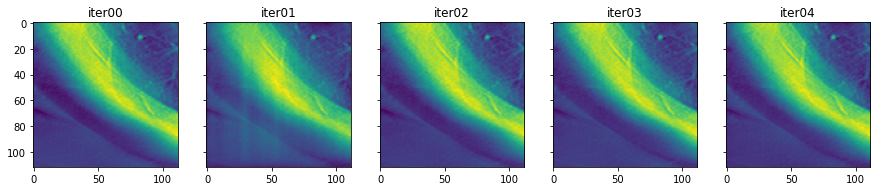

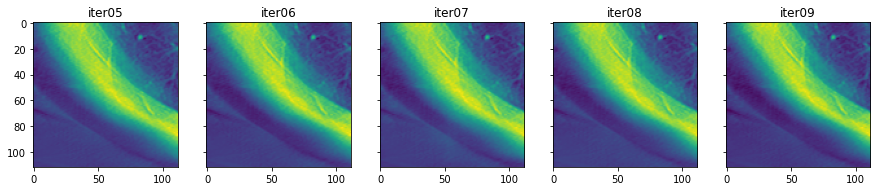

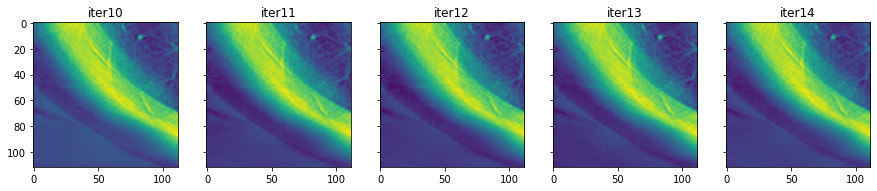

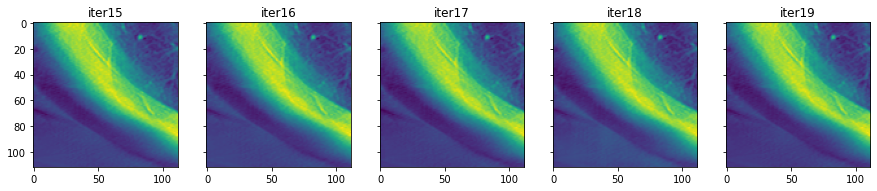

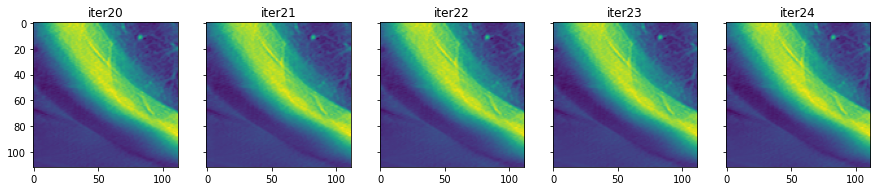

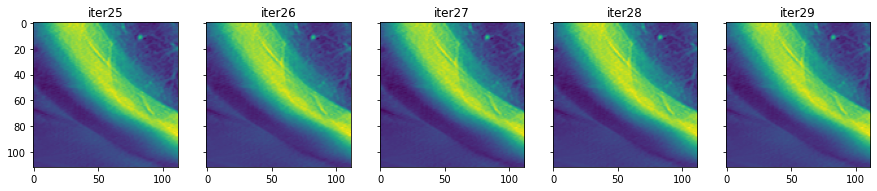

In [2]:
angular_extent = 31
results_path = os.path.join(PARENT_PATH, 'data/isoNet/lung_dummyData_ae%02d/results/' %angular_extent)
minipatch_file = os.path.join(results_path, 'lung_031_corrupted_ae%02d_000001_%s.mrc' %(angular_extent, '%s'))

n_iter = len(glob(results_path+'lung_031_corrupted_ae%02d_000001_iter*' %angular_extent))

fig, ax = plt.subplots(1, 5, figsize=(15,10), sharey=True)

for i in list(range(0, n_iter-1)):
    iter_no = 'iter%02d'%i
    aux_file = minipatch_file %iter_no
    minipatch = read_array(aux_file)
    z_idx = minipatch.shape[0]//2
    rowcount = i%5
    
    if rowcount==0 and i>0:
        plt.show()
        fig, ax = plt.subplots(1, 5, figsize=(15,10), sharey=True)
        ax[rowcount].imshow(minipatch[z_idx])
        ax[rowcount].set_title(iter_no)
    else:
        ax[rowcount].imshow(minipatch[z_idx])
        ax[rowcount].set_title(iter_no)

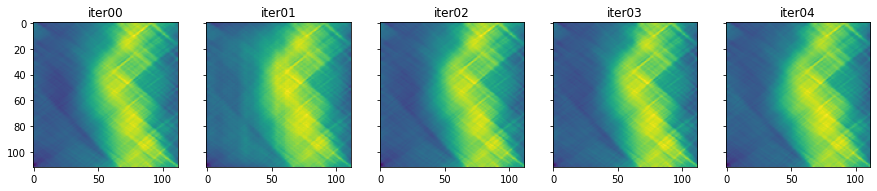

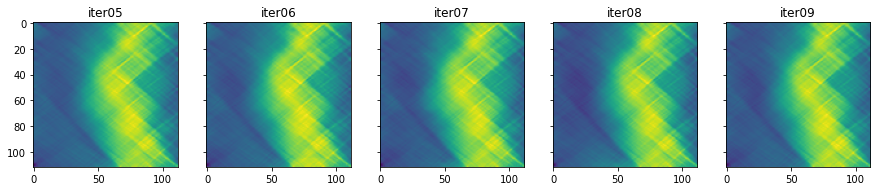

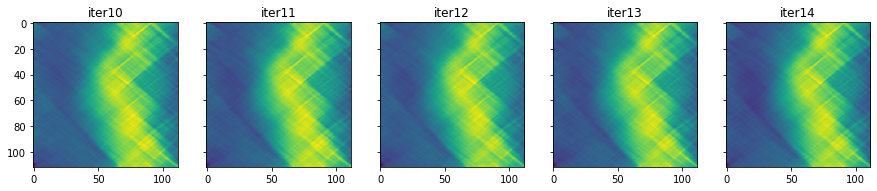

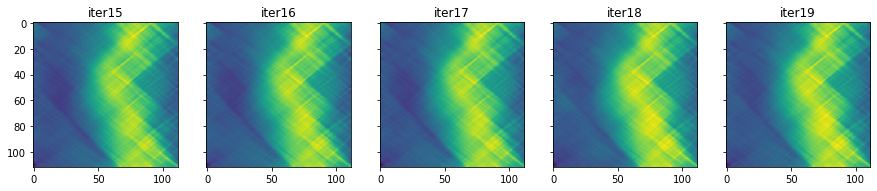

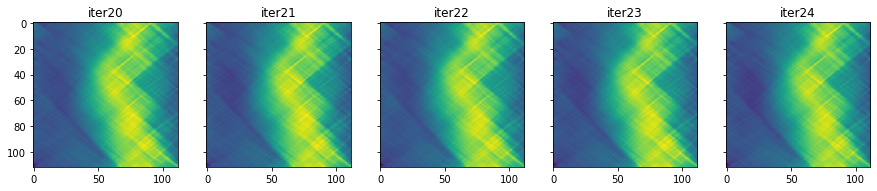

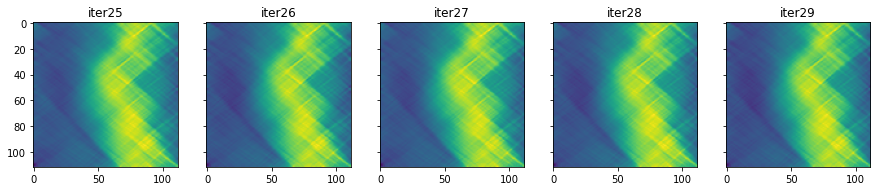

In [3]:
fig, ax = plt.subplots(1, 5, figsize=(15,10), sharey=True)

for i in list(range(n_iter-1)):
    iter_no = 'iter%02d'%i
    aux_file = minipatch_file %iter_no
    minipatch = read_array(aux_file)
    y_idx = minipatch.shape[1]//2
    rowcount = i%5
    
    if rowcount==0 and i>0:
        plt.show()
        fig, ax = plt.subplots(1, 5, figsize=(15,10), sharey=True)
        ax[rowcount].imshow(minipatch[:, y_idx, :])
        ax[rowcount].set_title(iter_no)
    else:
        ax[rowcount].imshow(minipatch[:, y_idx, :])
        ax[rowcount].set_title(iter_no)

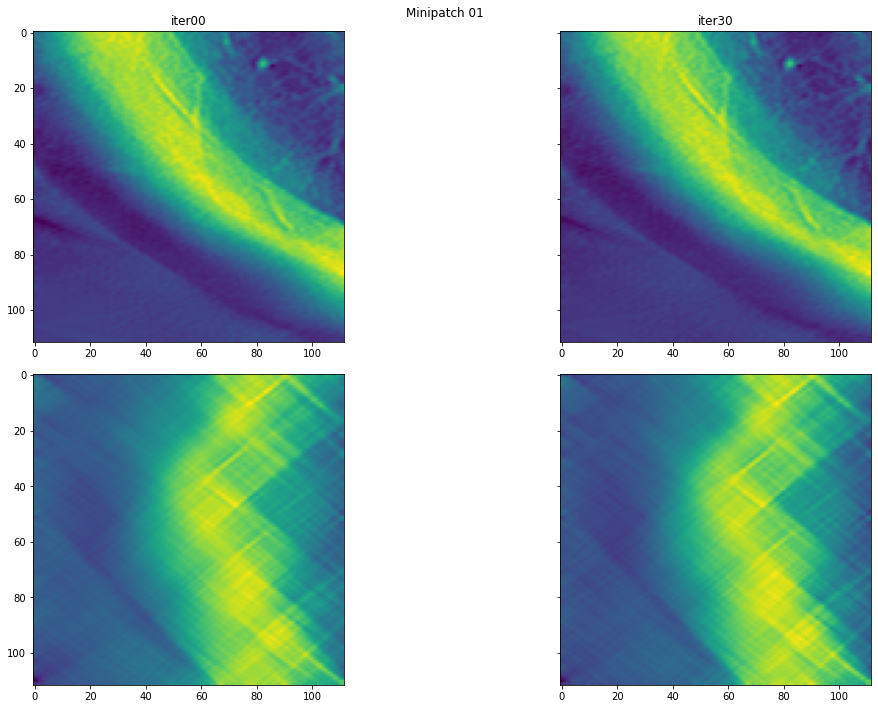

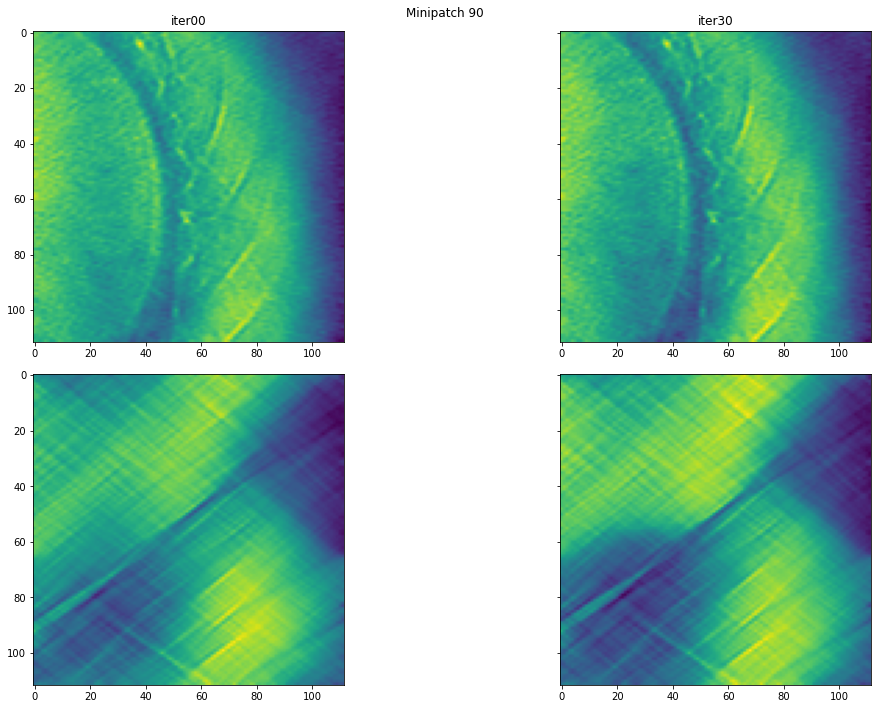

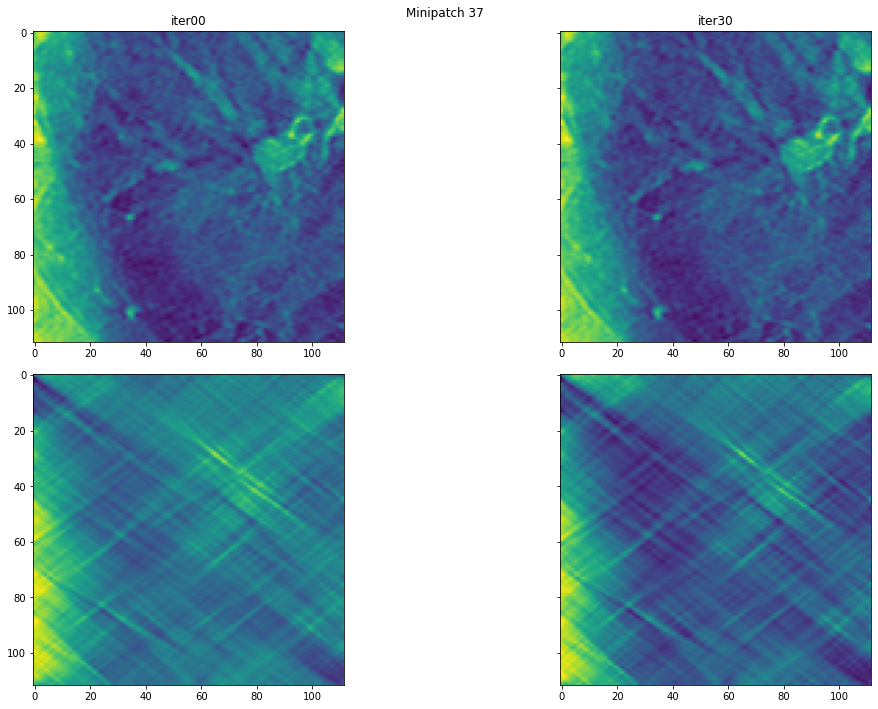

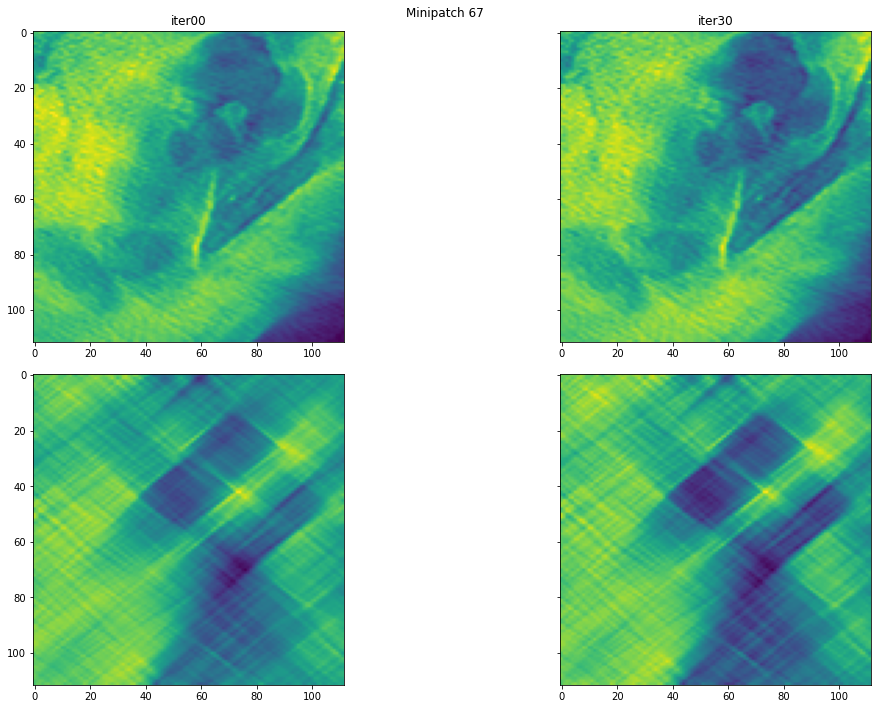

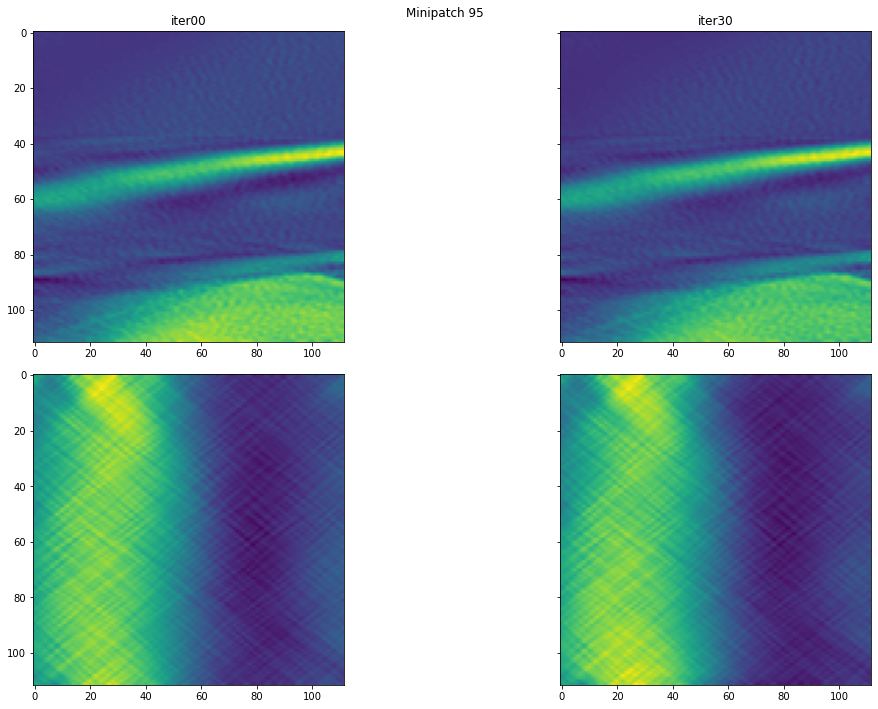

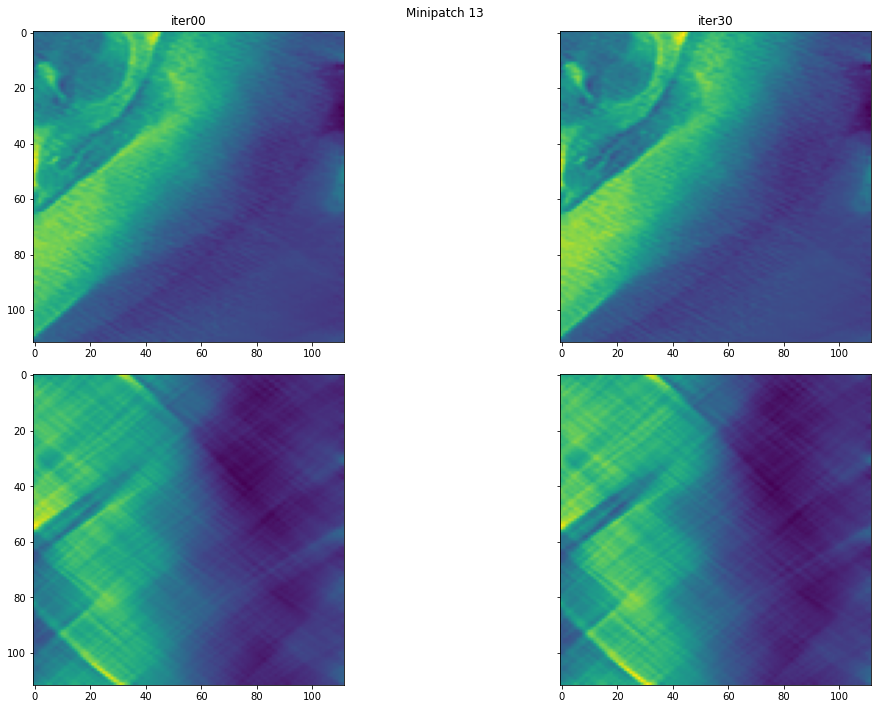

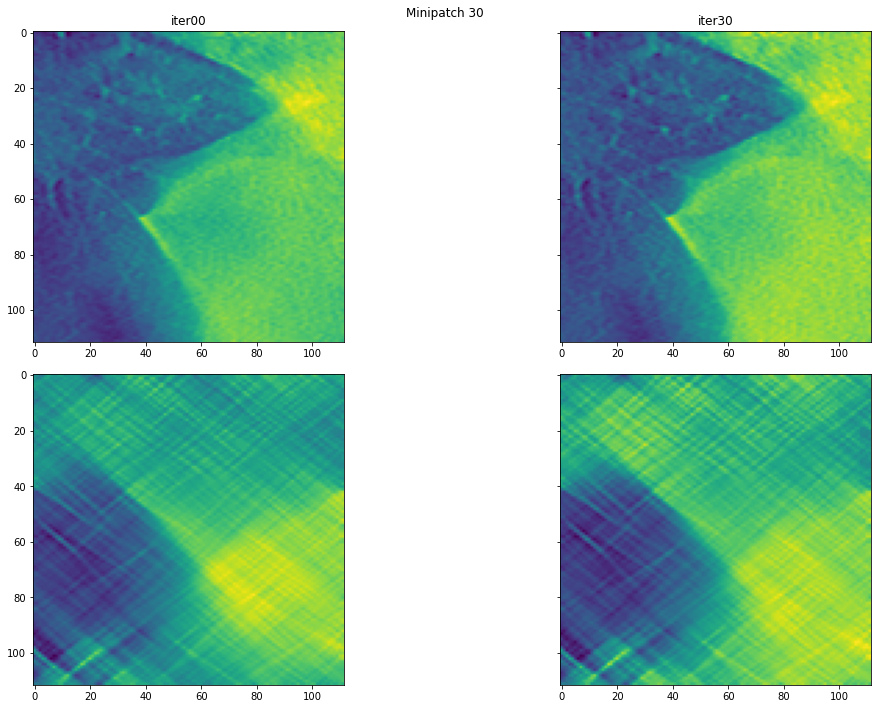

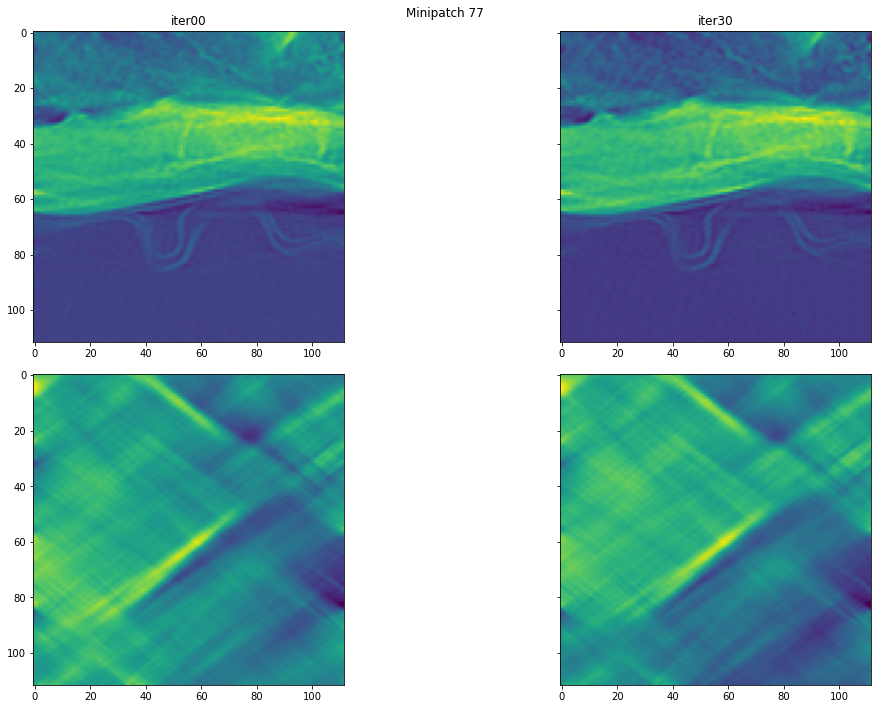

In [9]:
results_path = os.path.join(PARENT_PATH, 'data/isoNet/lung_dummyData_ae%02d/results/' %angular_extent)

# for k in random.sample(range(0, 100), 10):
for k in [1, 90, 37, 67, 95, 13, 30, 77]:
    
    minipatch_file = os.path.join(results_path, 'lung_031_corrupted_ae%02d_0000%s_%s.mrc' %(angular_extent, '%02d', '%s'))

    fig, ax = plt.subplots(2, 2, figsize=(15,10), sharey=True)
    fig.suptitle('Minipatch %02d' %k)
    fig.tight_layout()
    # fig.subplots_adjust(top=0.88)

    for i, j in enumerate([0, 30]):
        iter_no = 'iter%02d'%j
        aux_file = minipatch_file %(k, iter_no)
        minipatch = read_array(aux_file)
        z_idx = minipatch.shape[0]//2
        y_idx = minipatch.shape[0]//2
        
        ax[0][i].imshow(minipatch[z_idx])
        ax[0][i].set_title(iter_no)
        
        ax[1][i].imshow(minipatch[:, y_idx, :])
        
    plt.show()

## Overview of Workflow stages

reading raw...
reading mask...
reading corrected...


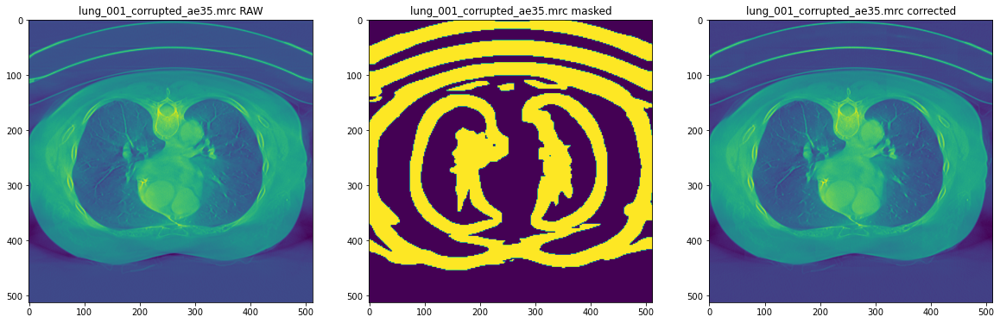

In [3]:
angular_extent = 35

raw_tomo_path = os.path.join(ISONET_PATH, 'lung_dummyData_ae%02d/lung_corrupted/' %angular_extent)
mask_tomo_path = os.path.join(ISONET_PATH, 'lung_dummyData_ae%02d/tomos_mask/' %angular_extent)
corrected_tomo_path = os.path.join(ISONET_PATH, 'lung_dummyData_ae%02d/corrected_i30/' %angular_extent)


img_base_path = os.path.join(PARENT_PATH, 'data/decathlon_dataset/Task06_Lung/imagesTr/')
img_paths = [os.path.join(img_base_path, 'lung_%03d.nii.gz'%x) for x in [1, 9, 20, 31]]


isonet_training_tomos = ['lung_%03d_corrupted_ae%02d.mrc'%(x, angular_extent) for x in [1, 9, 20, 31]]

for tomo in sorted(isonet_training_tomos):

    print('reading raw...')
    raw_data = read_array(os.path.join(raw_tomo_path, tomo))
    
    print('reading mask...')
    masked_data = read_array(os.path.join(mask_tomo_path, tomo[0:-4]+'_mask.mrc'))
    
    print('reading corrected...')
    corrected_data = read_array(os.path.join(corrected_tomo_path, tomo[0:-4]+'_corrected.mrc'))
    
    fig, ax = plt.subplots(1, 3, figsize=(20, 15))
        
    z_idx = raw_data.shape[0]//2
    ax[0].imshow(raw_data[z_idx])
    ax[0].set_title(tomo + ' RAW')
    ax[1].imshow(masked_data[z_idx])
    ax[1].set_title(tomo + ' masked')
    ax[2].imshow(corrected_data[z_idx])
    ax[2].set_title(tomo + ' corrected')
    
    plt.show()
    break

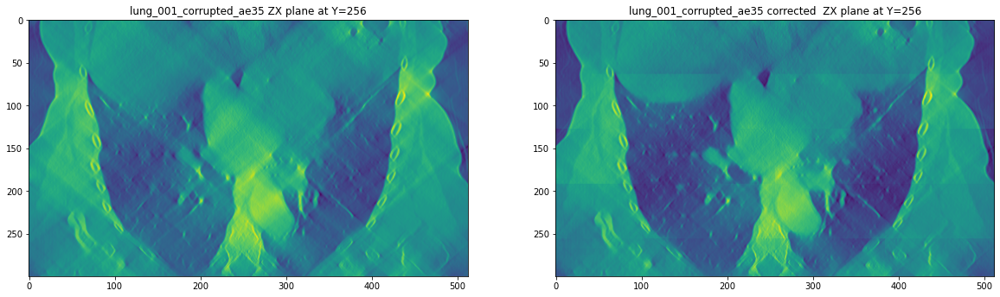

In [4]:
fig, ax = plt.subplots(1, 2, figsize=(20, 15))

y_idx = raw_data.shape[1]//2
ax[0].imshow(raw_data[:, y_idx, :])
ax[0].set_title(tomo.replace('.mrc', '') + ' ZX plane at Y=%i' %y_idx)
# ax[1].imshow(masked_data[:, y_idx, :])
# ax[1].set_title(tomo + ' masked')
ax[1].imshow(corrected_data[:, y_idx, :])
ax[1].set_title(tomo.replace('.mrc', '') + ' corrected  ZX plane at Y=%i' %y_idx)

plt.show()

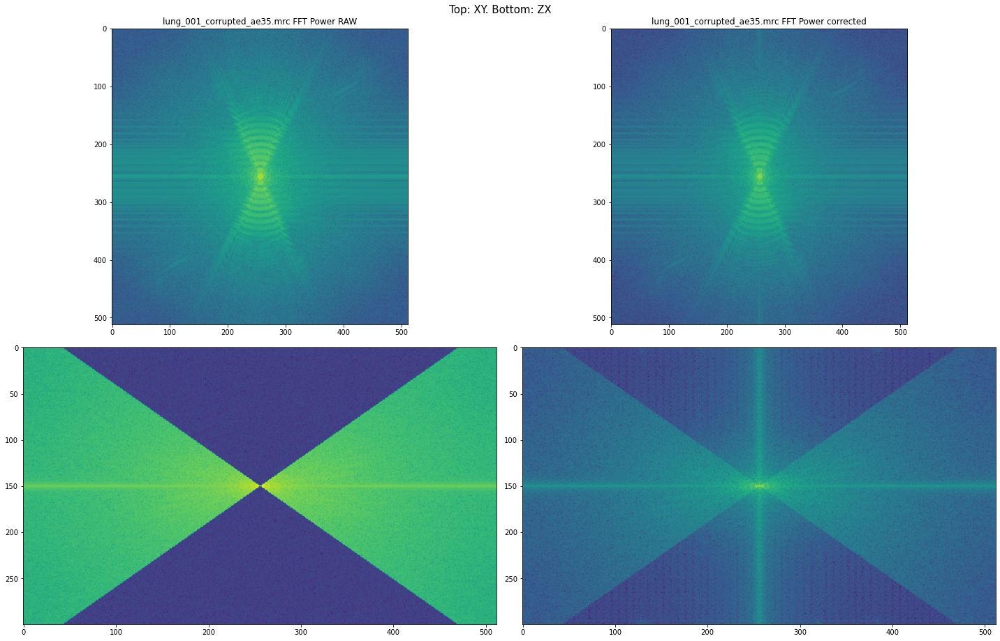

In [5]:
tomo_shape = raw_data.shape

subtomo_raw_fft = np.fft.fftshift(np.fft.fftn(raw_data))
log_power_raw = np.log(np.abs(subtomo_raw_fft)**2)

subtomo_corrected_fft = np.fft.fftshift(np.fft.fftn(corrected_data))
log_power_corrected = np.log(np.abs(subtomo_corrected_fft)**2)

fig, ax = plt.subplots(2, 2, figsize=(20, 13))
        
fig.suptitle('Top: XY. Bottom: ZX', fontsize=15)    

z_idx = raw_data.shape[0]//2
ax[0][0].imshow(log_power_raw[tomo_shape[0]//2])
ax[0][0].set_title(tomo + ' FFT Power RAW')
ax[0][1].imshow(log_power_corrected[tomo_shape[0]//2])
ax[0][1].set_title(tomo + ' FFT Power corrected')

ax[1][0].imshow(log_power_raw[:, tomo_shape[1]//2, :])
ax[1][1].imshow(log_power_corrected[:, tomo_shape[1]//2, :])

# plt.subplots_adjust(hspace = -0.5)
plt.tight_layout()
plt.show()

## Quantintative results

In [6]:
def clip_and_standardize(X, low=0.005, high=0.995, quantiles=True):
    if quantiles:
        X_clp = np.clip(X, np.quantile(X, low), np.quantile(X, high))
    else:
        X_clp = np.clip(X, low, high)
    X_stdz = (X_clp-np.mean(X_clp))/np.std(X_clp)
    
    return X_stdz

- SSIM GT vs Corrupted:  0.5554869373258952
- SSIM GT vs Corrected:  0.6121362075118388
- NMI GT vs Corrupted:  1.121669688406709
- NMI GT vs Corrected:  1.1257914156505737


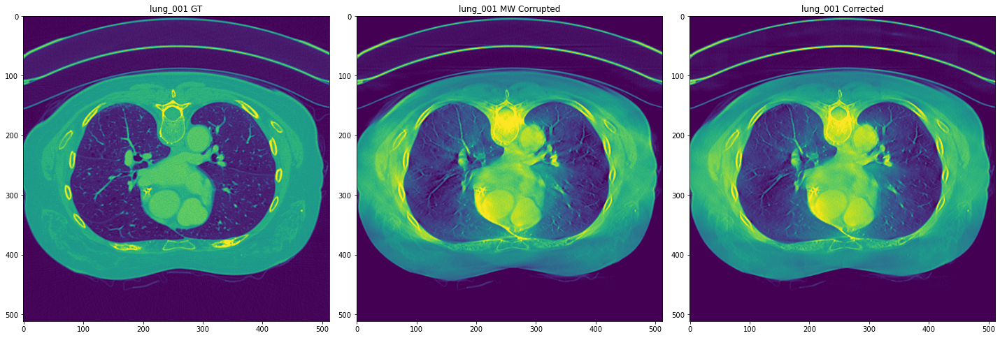

--------------------------------------------------------------------------------------------------------------------------------------------------------
- SSIM GT vs Corrupted:  0.5858530704876148
- SSIM GT vs Corrected:  0.6286205837433457
- NMI GT vs Corrupted:  1.1284819982727705
- NMI GT vs Corrected:  1.1370549119042603


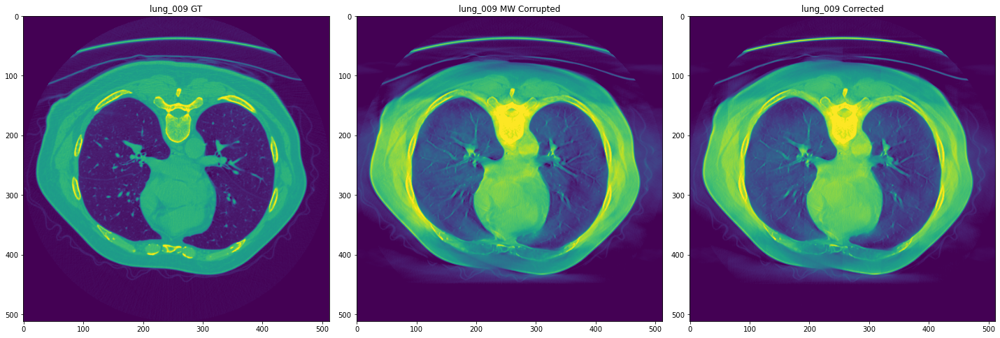

--------------------------------------------------------------------------------------------------------------------------------------------------------
- SSIM GT vs Corrupted:  0.5467982667967604
- SSIM GT vs Corrected:  0.596454854648077
- NMI GT vs Corrupted:  1.1137020667941502
- NMI GT vs Corrected:  1.1147861907174506


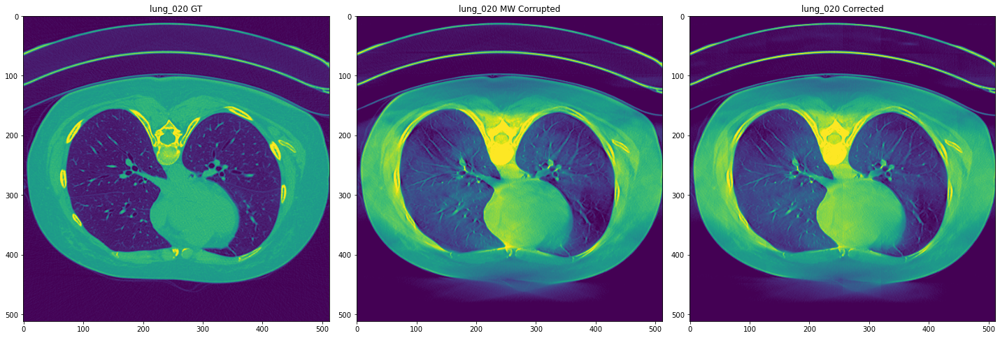

--------------------------------------------------------------------------------------------------------------------------------------------------------
- SSIM GT vs Corrupted:  0.6013082432756208
- SSIM GT vs Corrected:  0.6320718684879829
- NMI GT vs Corrupted:  1.116944038133727
- NMI GT vs Corrected:  1.1255725458221488


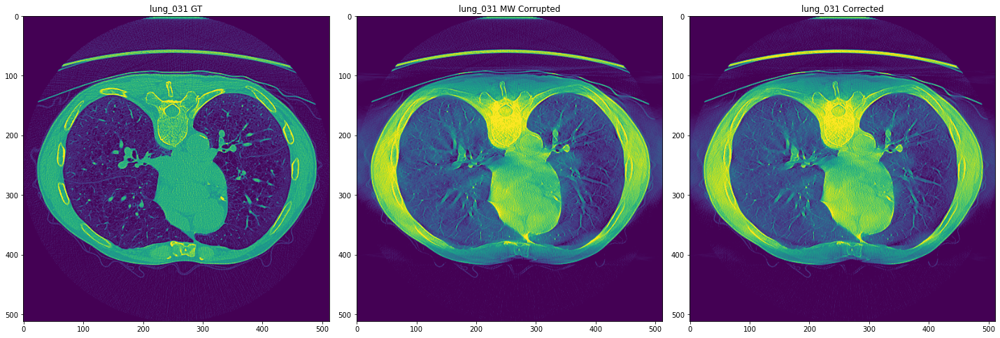

--------------------------------------------------------------------------------------------------------------------------------------------------------


In [7]:
angular_extent = 35

raw_tomo_path = os.path.join(ISONET_PATH, 'lung_dummyData_ae%02d/lung_corrupted/' %angular_extent)
mask_tomo_path = os.path.join(ISONET_PATH, 'lung_dummyData_ae%02d/tomos_mask/' %angular_extent)
corrected_tomo_path = os.path.join(ISONET_PATH, 'lung_dummyData_ae%02d/corrected_i30/' %angular_extent)

img_base_path = os.path.join(PARENT_PATH, 'data/decathlon_dataset/Task06_Lung/imagesTr/')

mean_gt_vs_corrupt_ssim = []
mean_gt_vs_corrected_ssim = []

mean_gt_vs_corrupt_nmi = []
mean_gt_vs_corrected_nmi = []

for i in [1, 9, 20, 31]:
    gt_data = os.path.join(img_base_path, 'lung_%03d.nii.gz'%i)
    gt_data = read_array(gt_data)
    # standardize
    gt_data = (gt_data-np.mean(gt_data))/np.std(gt_data)
    # clip values
    gt_data = np.clip(gt_data, np.quantile(gt_data, 0.005), np.quantile(gt_data, 0.995))
    
    corrupted_data = read_array(os.path.join(raw_tomo_path, 'lung_%03d_corrupted_ae%02d.mrc'%(i, angular_extent)))
    # standardize first
    corrupted_data = (corrupted_data-np.mean(corrupted_data))/np.std(corrupted_data)
    # now clip according to ground truth values
    corrupted_data = np.clip(corrupted_data, np.min(gt_data), np.max(gt_data))
    
    corrected_data = read_array(os.path.join(corrected_tomo_path, 'lung_%03d_corrupted_ae%02d_corrected.mrc'%(i, angular_extent)))
    # standardize first
    corrected_data = (corrected_data-np.mean(corrected_data))/np.std(corrected_data)
    # now clip according to ground truth values
    corrected_data = np.clip(corrected_data, np.min(gt_data), np.max(gt_data))
    
    z, y, x = corrupted_data.shape
    gt_data = gt_data[0:z, 0:y, 0:x]
    
    # scale all
    gt_data = minmax_scaler(gt_data)
    corrupted_data = minmax_scaler(corrupted_data)
    corrected_data = minmax_scaler(corrected_data)
    
    gt_vs_corrupt_ssim, gt_vs_corrected_ssim = ssim(gt_data, corrupted_data), ssim(gt_data, corrected_data)
    mean_gt_vs_corrupt_ssim.append(gt_vs_corrupt_ssim)
    mean_gt_vs_corrected_ssim.append(gt_vs_corrected_ssim)
    
    gt_vs_corrupt_nmi, gt_vs_corrected_nmi = nmi(gt_data, corrupted_data), nmi(gt_data, corrected_data)
    mean_gt_vs_corrupt_nmi.append(gt_vs_corrupt_nmi)
    mean_gt_vs_corrected_nmi.append(gt_vs_corrected_nmi)
    
    print('- SSIM GT vs Corrupted: ', gt_vs_corrupt_ssim)
    print('- SSIM GT vs Corrected: ', gt_vs_corrected_ssim)
    print('- NMI GT vs Corrupted: ', gt_vs_corrupt_nmi)
    print('- NMI GT vs Corrected: ', gt_vs_corrected_nmi)
    
    
    fig, ax = plt.subplots(1, 3, figsize=(20, 15))
    
    z_idx = gt_data.shape[0]//2
        
    ax[0].imshow(gt_data[z_idx])
    ax[0].set_title('lung_%03d GT' %i)
    ax[1].imshow(corrupted_data[z_idx])
    ax[1].set_title('lung_%03d MW Corrupted' %i)
    ax[2].imshow(corrected_data[z_idx])
    ax[2].set_title('lung_%03d Corrected' %i)
    
    # plt.suptitle('Comparison of XY planes for Z=%03d' %z_idx)
    plt.tight_layout()
    plt.show()
    
    print('--------------------------------------------------------------------------------------------------------------------------------------------------------')

In [8]:
np.mean(mean_gt_vs_corrupt_ssim), np.mean(mean_gt_vs_corrected_ssim)

(0.5723616294714727, 0.6173208785978112)

In [9]:
np.mean(mean_gt_vs_corrupt_nmi), np.mean(mean_gt_vs_corrected_nmi)

(1.1201994479018391, 1.1258012660236085)

# Brain Dummy

## Intermediate results

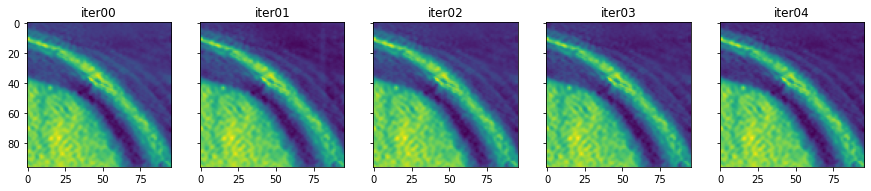

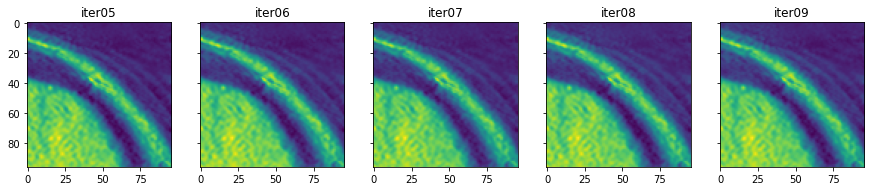

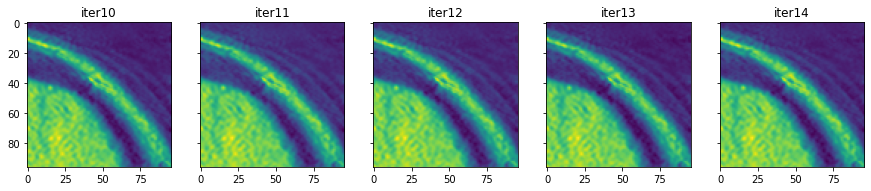

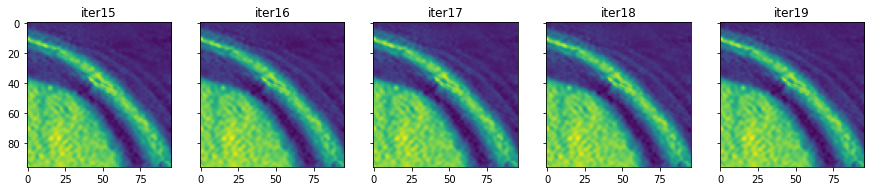

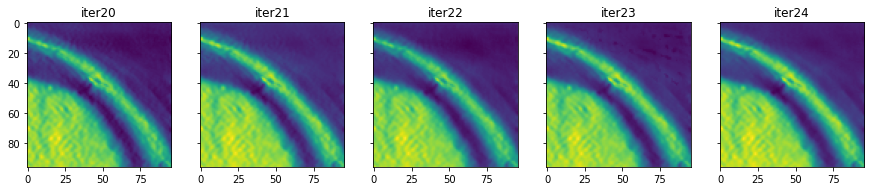

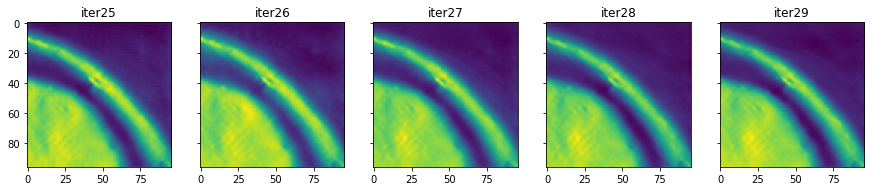

In [3]:
results_path = os.path.join(PARENT_PATH, 'data/isoNet/brain_dummyData/results/')
minipatch_file = os.path.join(results_path, 'IXI002-Guys-0828-MRA_corrupted_12_000000_%s.mrc')

n_iter = len(glob(results_path+'IXI002-Guys-0828-MRA_corrupted_12_000001_iter*'))

fig, ax = plt.subplots(1, 5, figsize=(15,10), sharey=True)

for i in list(range(0, n_iter-1)):
    iter_no = 'iter%02d'%i
    aux_file = minipatch_file %iter_no
    minipatch = read_array(aux_file)
    z_idx = minipatch.shape[0]//2
    rowcount = i%5
    
    if rowcount==0 and i>0:
        plt.show()
        fig, ax = plt.subplots(1, 5, figsize=(15,10), sharey=True)
        ax[rowcount].imshow(minipatch[z_idx])
        ax[rowcount].set_title(iter_no)
    else:
        ax[rowcount].imshow(minipatch[z_idx])
        ax[rowcount].set_title(iter_no)

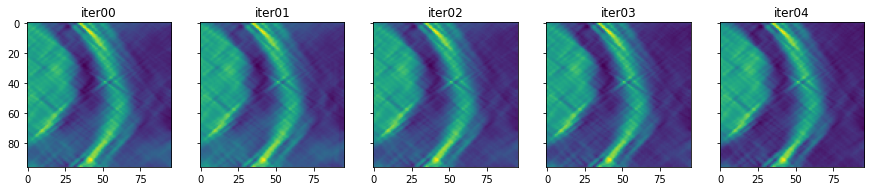

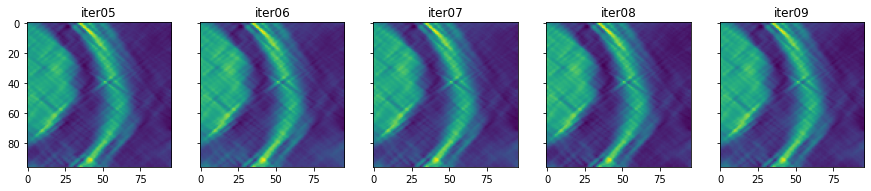

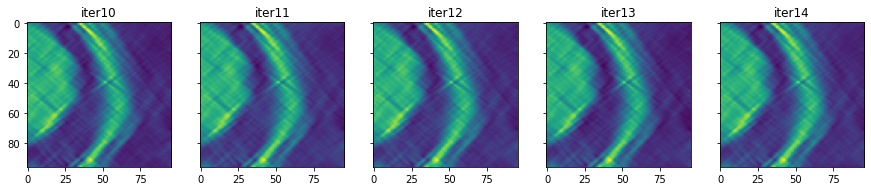

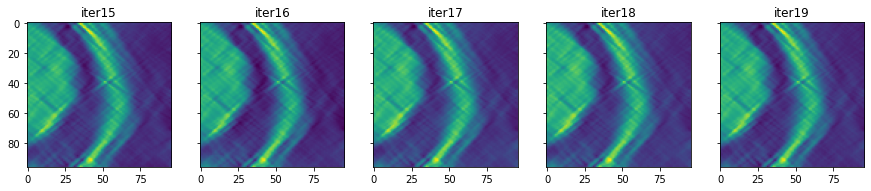

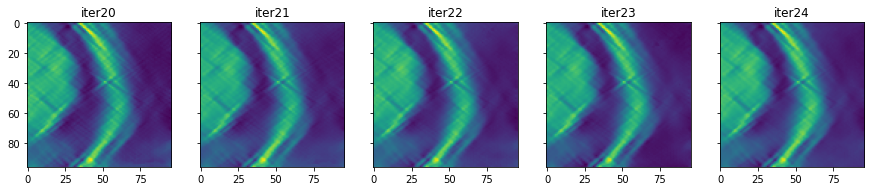

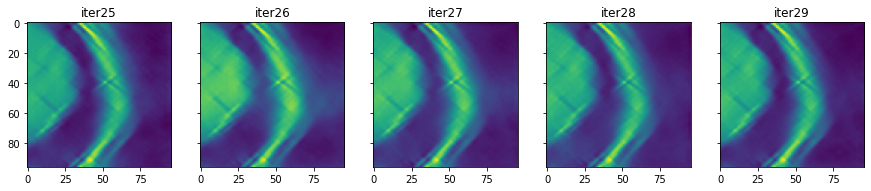

In [4]:
fig, ax = plt.subplots(1, 5, figsize=(15,10), sharey=True)

for i in list(range(n_iter-1)):
    iter_no = 'iter%02d'%i
    aux_file = minipatch_file %iter_no
    minipatch = read_array(aux_file)
    y_idx = minipatch.shape[1]//2
    rowcount = i%5
    
    if rowcount==0 and i>0:
        plt.show()
        fig, ax = plt.subplots(1, 5, figsize=(15,10), sharey=True)
        ax[rowcount].imshow(minipatch[:, y_idx, :])
        ax[rowcount].set_title(iter_no)
    else:
        ax[rowcount].imshow(minipatch[:, y_idx, :])
        ax[rowcount].set_title(iter_no)

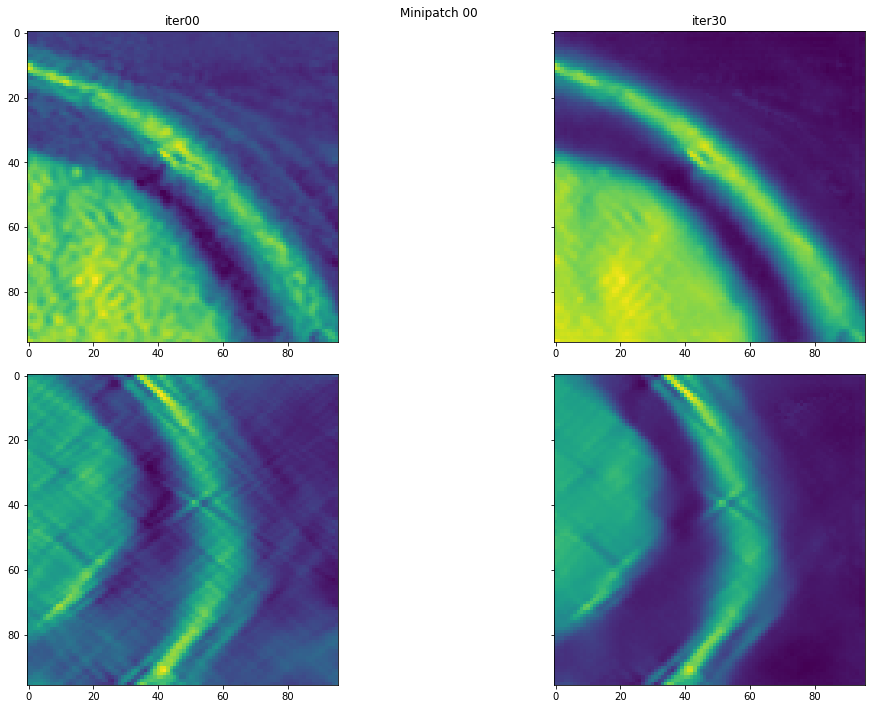

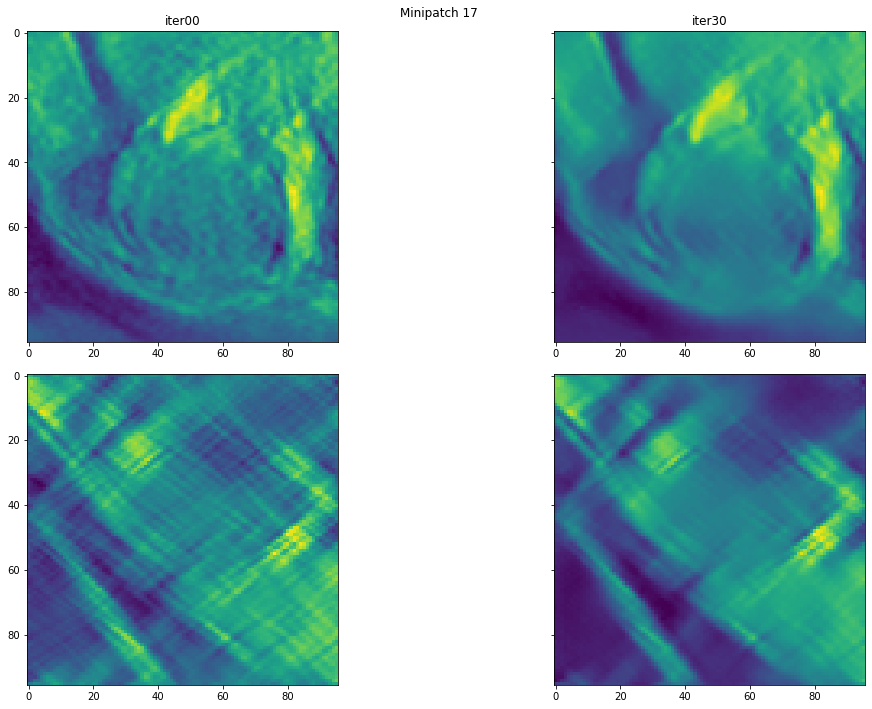

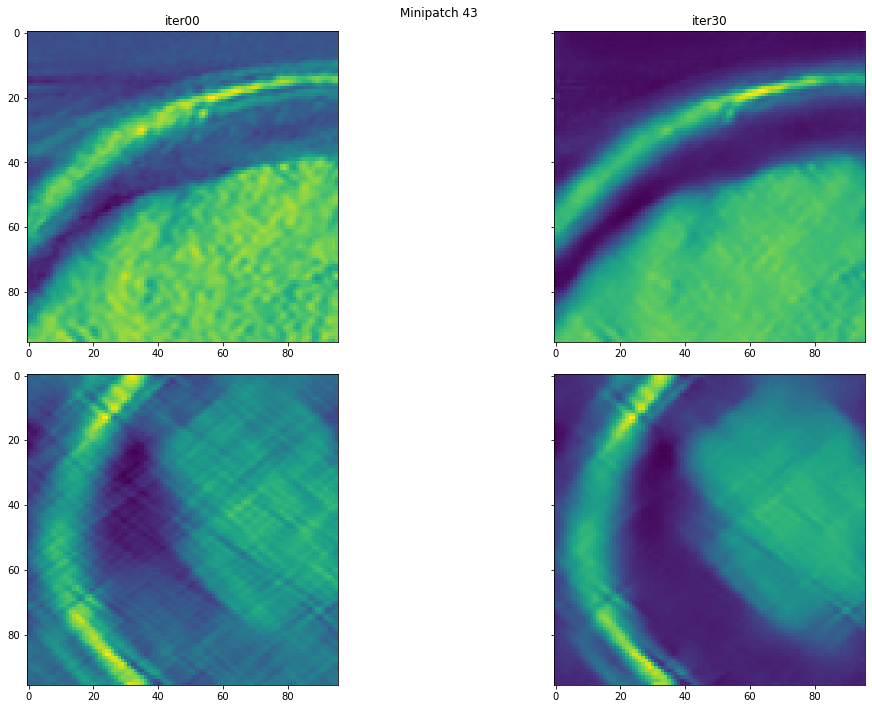

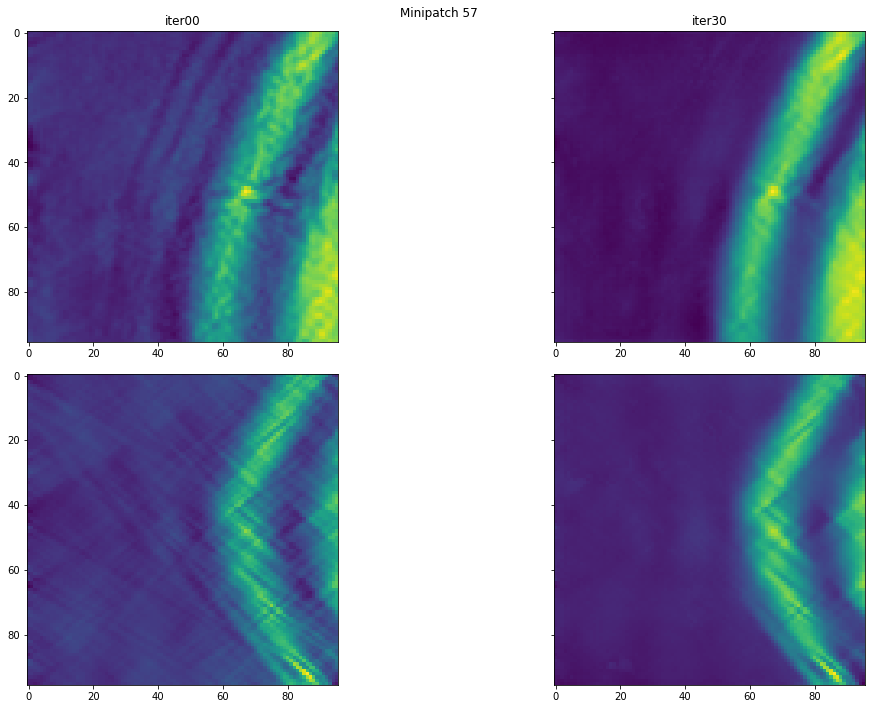

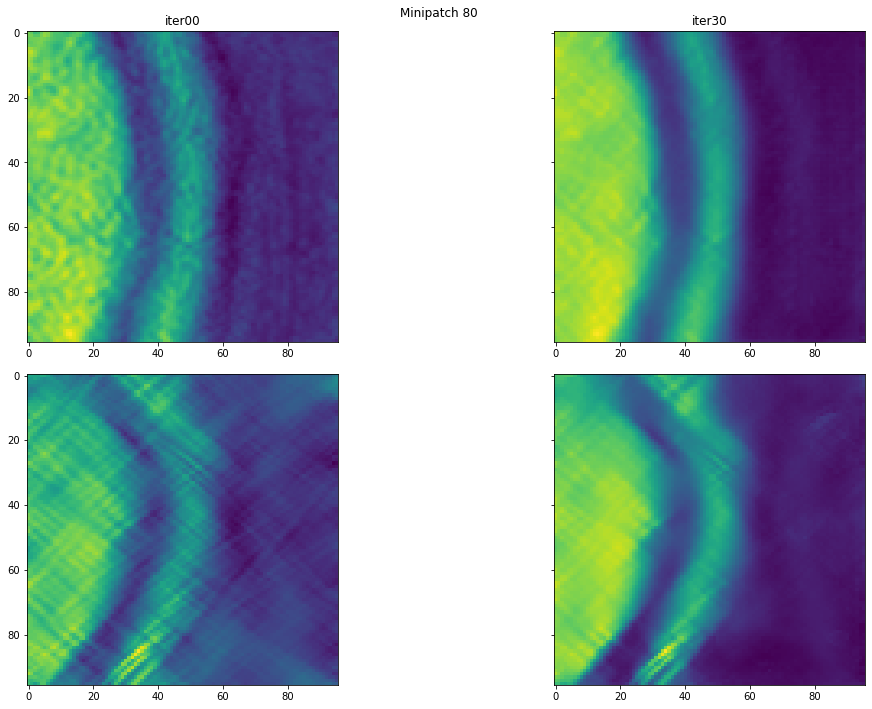

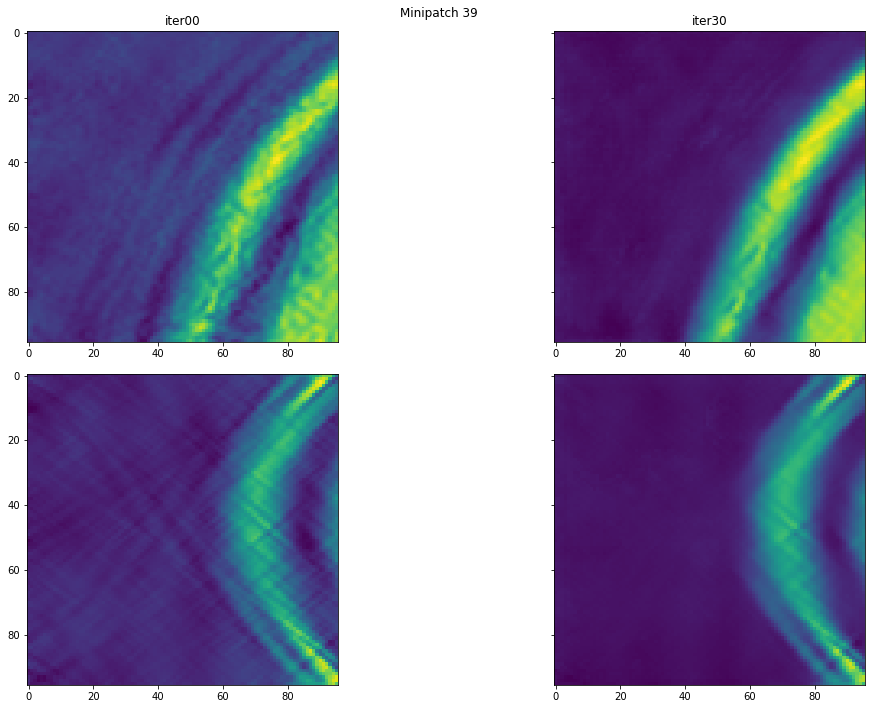

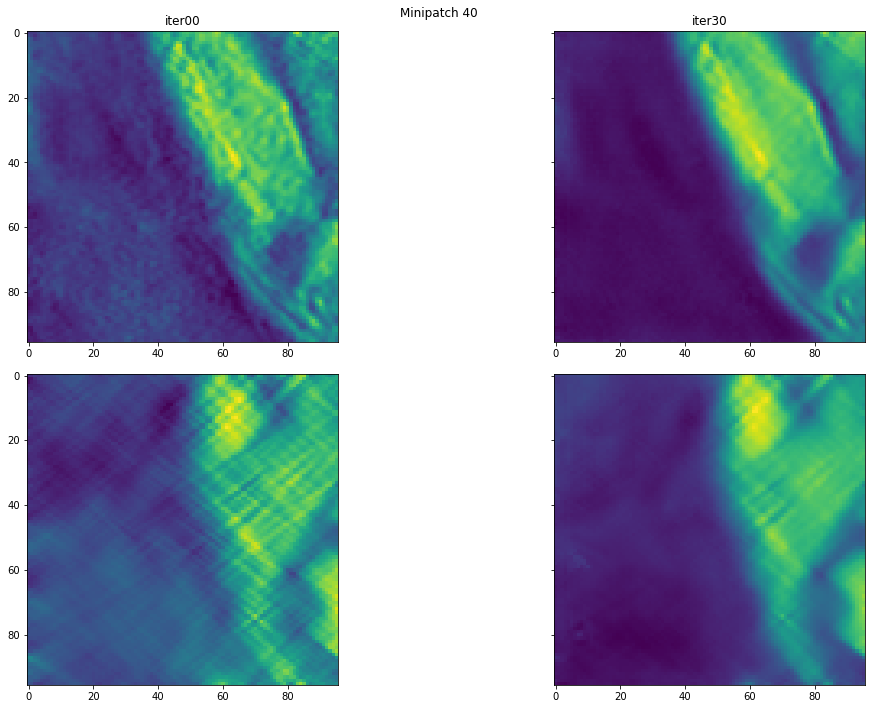

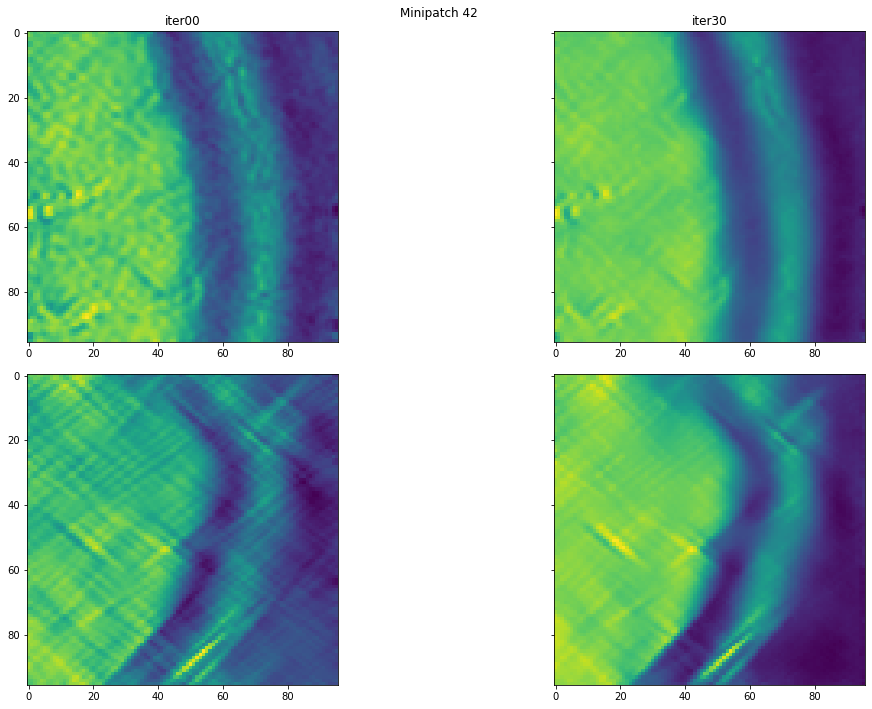

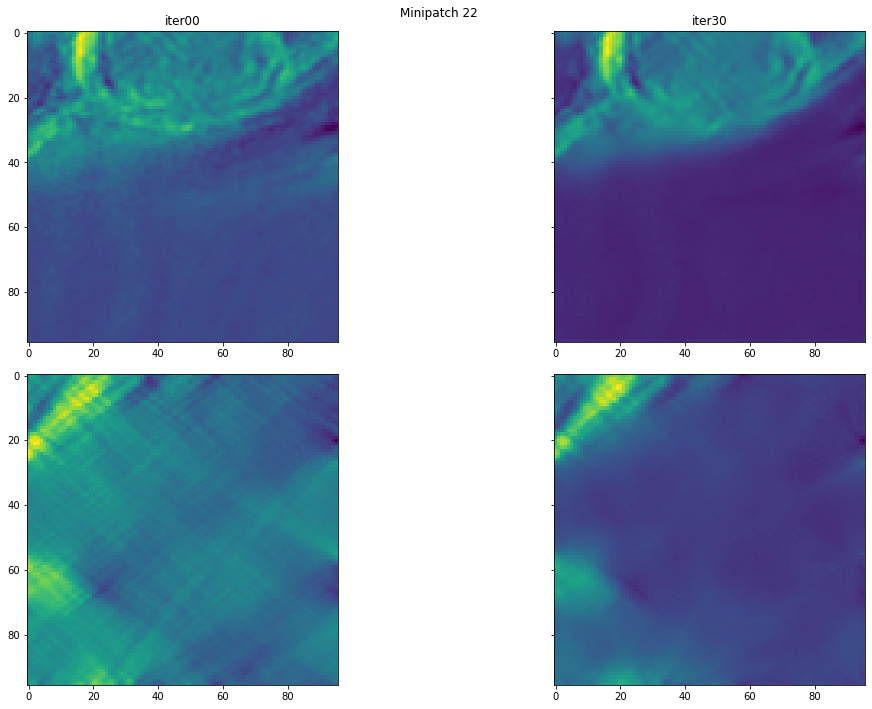

In [6]:
results_path = os.path.join(PARENT_PATH, 'data/isoNet/brain_dummyData/results/')
    
# for k in random.sample(range(0, 100), 10):
for k in [0, 17, 43, 57, 80, 39, 40, 42, 22]:
        
    minipatch_file = os.path.join(results_path, 'IXI002-Guys-0828-MRA_corrupted_12_0000%02d_%s.mrc')

    fig, ax = plt.subplots(2, 2, figsize=(15,10), sharey=True)
    fig.suptitle('Minipatch %02d' %k)
    fig.tight_layout()
    # fig.subplots_adjust(top=0.88)

    for i, j in enumerate([0, 30]):
        iter_no = 'iter%02d'%j
        aux_file = minipatch_file %(k, iter_no)
        minipatch = read_array(aux_file)
        z_idx = minipatch.shape[0]//2
        y_idx = minipatch.shape[0]//2
        
        ax[0][i].imshow(minipatch[z_idx])
        ax[0][i].set_title(iter_no)
        
        ax[1][i].imshow(minipatch[:, y_idx, :])
        
    plt.show()

## Overview of Workflow stages

reading raw...
reading mask...
reading corrected...


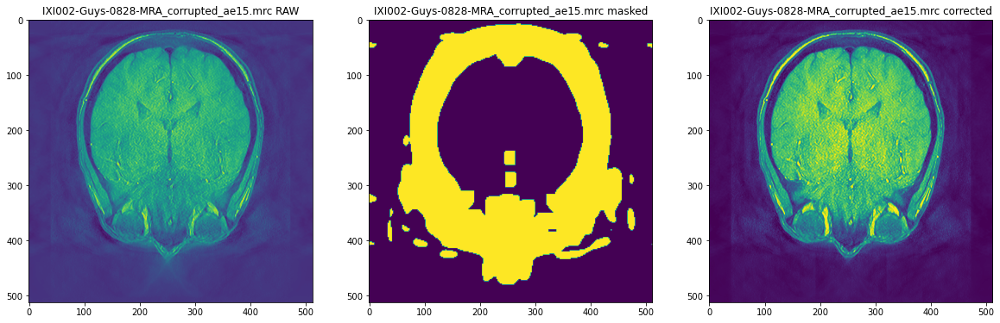

In [11]:
raw_tomo_path = os.path.join(ISONET_PATH, 'brain_dummyData_ae15/brain_corrupted/')
mask_tomo_path = os.path.join(ISONET_PATH, 'brain_dummyData_ae15/tomos_mask/')
corrected_tomo_path = os.path.join(ISONET_PATH, 'brain_dummyData_ae15/corrected_i30/')

isonet_training_tomos = ['IXI002-Guys-0828-MRA_corrupted_ae15.mrc']

for tomo in sorted(isonet_training_tomos):
    print('reading raw...')
    raw_data = read_array(os.path.join(raw_tomo_path, tomo))
    
    print('reading mask...')
    masked_data = read_array(os.path.join(mask_tomo_path, tomo[0:-4]+'_mask.mrc'))
    
    print('reading corrected...')
    corrected_data = clip_values(read_array(os.path.join(corrected_tomo_path, tomo[0:-4]+'_corrected.mrc')))
    
    fig, ax = plt.subplots(1, 3, figsize=(20, 15))
        
    z_idx = raw_data.shape[0]//2
    ax[0].imshow(raw_data[z_idx])
    ax[0].set_title(tomo + ' RAW')
    ax[1].imshow(masked_data[z_idx])
    ax[1].set_title(tomo + ' masked')
    ax[2].imshow(corrected_data[z_idx])
    ax[2].set_title(tomo + ' corrected')
    
    plt.show()

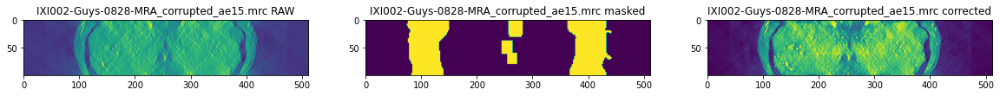

In [12]:
fig, ax = plt.subplots(1, 3, figsize=(20, 15))

y_idx = raw_data.shape[1]//2
ax[0].imshow(raw_data[:, y_idx, :])
ax[0].set_title(tomo + ' RAW')
ax[1].imshow(masked_data[:, y_idx, :])
ax[1].set_title(tomo + ' masked')
ax[2].imshow(corrected_data[:, y_idx, :])
ax[2].set_title(tomo + ' corrected')

plt.show()

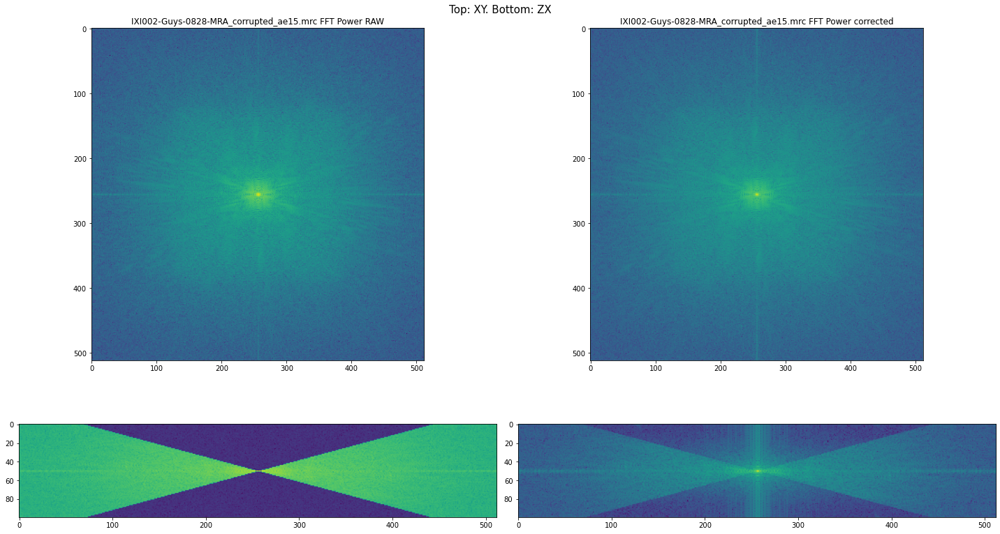

In [13]:
tomo_shape = raw_data.shape

subtomo_raw_fft = np.fft.fftshift(np.fft.fftn(raw_data))
log_power_raw = np.log(np.abs(subtomo_raw_fft)**2)

subtomo_corrected_fft = np.fft.fftshift(np.fft.fftn(corrected_data))
log_power_corrected = np.log(np.abs(subtomo_corrected_fft)**2)

fig, ax = plt.subplots(2, 2, figsize=(20, 13))
        
fig.suptitle('Top: XY. Bottom: ZX', fontsize=15)    

z_idx = raw_data.shape[0]//2
ax[0][0].imshow(log_power_raw[tomo_shape[0]//2])
ax[0][0].set_title(tomo + ' FFT Power RAW')
ax[0][1].imshow(log_power_corrected[tomo_shape[0]//2])
ax[0][1].set_title(tomo + ' FFT Power corrected')

ax[1][0].imshow(log_power_raw[:, tomo_shape[1]//2, :])
ax[1][1].imshow(log_power_corrected[:, tomo_shape[1]//2, :])

# plt.subplots_adjust(hspace = -0.5)
plt.tight_layout()
plt.show()

## Quantitative results

In [10]:
# def standardize_and_clip(tomo_data, low=0.005, high=0.995):
#     tomo_data = (tomo_data-np.mean(tomo_data))/np.std(tomo_data)
#     aux = np.clip(tomo_data, np.quantile(tomo_data, low), np.quantile(tomo_data, high))
#     return aux

- SSIM GT vs Corrupted:  0.6803520480611844
- SSIM GT vs Corrected:  0.7290352844564738
- NMI GT vs Corrupted:  1.1400065256169856
- NMI GT vs Corrected:  1.1690172820742926


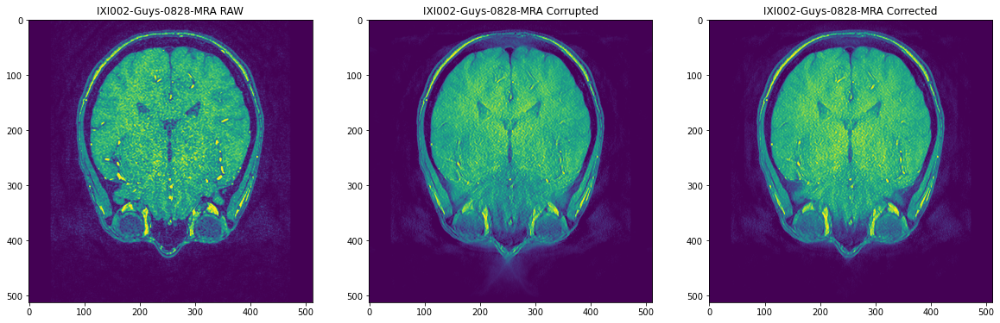

--------------------------------------------------------------------------------------------------------------------------------------------------------
- SSIM GT vs Corrupted:  0.701383230567034
- SSIM GT vs Corrected:  0.7486872617703856
- NMI GT vs Corrupted:  1.1455271289437812
- NMI GT vs Corrected:  1.1729922245064601


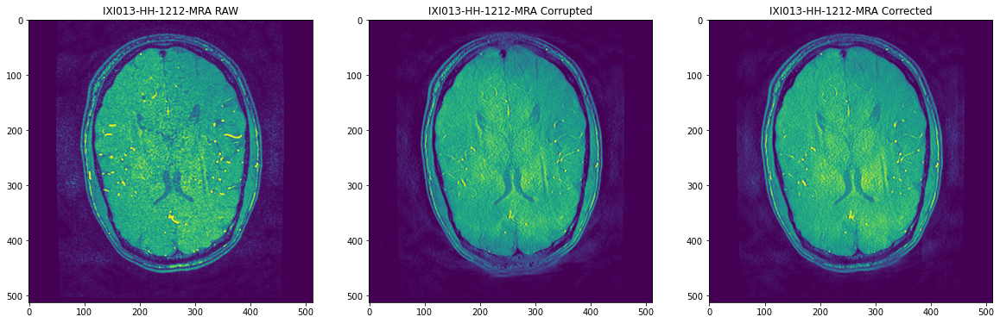

--------------------------------------------------------------------------------------------------------------------------------------------------------
- SSIM GT vs Corrupted:  0.6193602677065292
- SSIM GT vs Corrected:  0.6643765526738784
- NMI GT vs Corrupted:  1.1475570498019818
- NMI GT vs Corrected:  1.1738919207978835


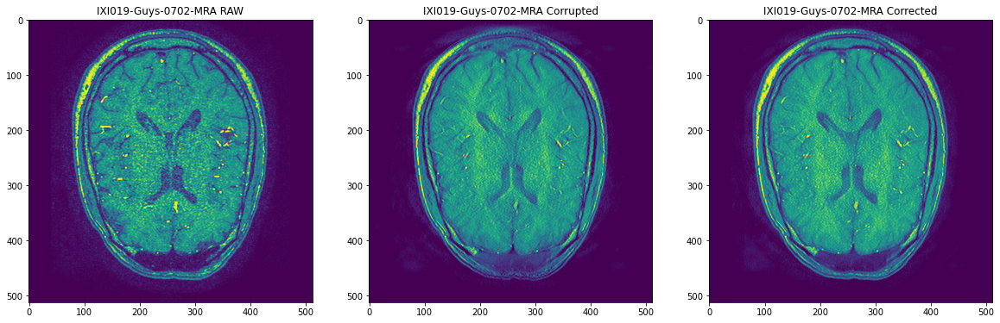

--------------------------------------------------------------------------------------------------------------------------------------------------------
- SSIM GT vs Corrupted:  0.6824993492615228
- SSIM GT vs Corrected:  0.724993149762044
- NMI GT vs Corrupted:  1.1613859927692147
- NMI GT vs Corrected:  1.1894238611825334


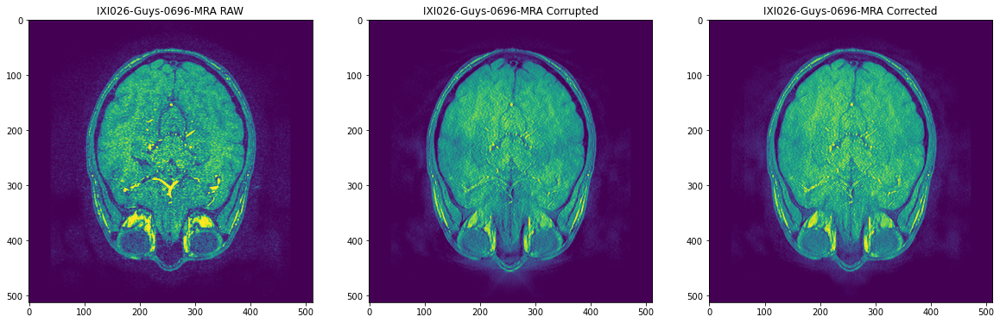

--------------------------------------------------------------------------------------------------------------------------------------------------------


In [ ]:
raw_tomo_path = os.path.join(ISONET_PATH, 'brain_dummyData_ae15/brain_corrupted/')
mask_tomo_path = os.path.join(ISONET_PATH, 'brain_dummyData_ae15/tomos_mask/')
corrected_tomo_path = os.path.join(ISONET_PATH, 'brain_dummyData_ae15/corrected_i30/')

img_base_path = os.path.join(PARENT_PATH, 'data/ixi_dataset/')

names = ['IXI002-Guys-0828-MRA', 'IXI013-HH-1212-MRA', 'IXI019-Guys-0702-MRA', 'IXI026-Guys-0696-MRA', 'IXI039-HH-1261-MRA']

mean_gt_vs_corrupt_ssim = []
mean_gt_vs_corrected_ssim = []

mean_gt_vs_corrupt_nmi = []
mean_gt_vs_corrected_nmi = []

for i in names:
    gt_data = os.path.join(img_base_path, '%s.nii.gz'%i)
    gt_data = read_array(gt_data)
    # standardize
    gt_data = (gt_data-np.mean(gt_data))/np.std(gt_data)
    # clip values
    gt_data = np.clip(gt_data, np.quantile(gt_data, 0.005), np.quantile(gt_data, 0.995))
    
    corrupted_data = os.path.join(raw_tomo_path, '%s_corrupted_ae15.mrc'%i)
    corrupted_data = read_array(corrupted_data)
    # standardize first
    corrupted_data = (corrupted_data-np.mean(corrupted_data))/np.std(corrupted_data)
    # now clip according to ground truth values
    corrupted_data = np.clip(corrupted_data, np.min(gt_data), np.max(gt_data))
    
    corrected_data = os.path.join(corrected_tomo_path, '%s_corrupted_ae15_corrected.mrc'%i)
    corrected_data = read_array(corrected_data)
    # standardize first
    corrected_data = (corrected_data-np.mean(corrected_data))/np.std(corrected_data)
    # now clip according to ground truth values
    corrected_data = np.clip(corrected_data, np.min(gt_data), np.max(gt_data))
    
    # scale all
    gt_data = minmax_scaler(gt_data)
    corrupted_data = minmax_scaler(corrupted_data)
    corrected_data = minmax_scaler(corrected_data)
    
    gt_vs_corrupt_ssim, gt_vs_corrected_ssim = ssim(gt_data, corrupted_data), ssim(gt_data, corrected_data)
    mean_gt_vs_corrupt_ssim.append(gt_vs_corrupt_ssim)
    mean_gt_vs_corrected_ssim.append(gt_vs_corrected_ssim)
    
    gt_vs_corrupt_nmi, gt_vs_corrected_nmi = nmi(gt_data, corrupted_data), nmi(gt_data, corrected_data)
    mean_gt_vs_corrupt_nmi.append(gt_vs_corrupt_nmi)
    mean_gt_vs_corrected_nmi.append(gt_vs_corrected_nmi)
    
    print('- SSIM GT vs Corrupted: ', gt_vs_corrupt_ssim)
    print('- SSIM GT vs Corrected: ', gt_vs_corrected_ssim)
    print('- NMI GT vs Corrupted: ', gt_vs_corrupt_nmi)
    print('- NMI GT vs Corrected: ', gt_vs_corrected_nmi)
    
    fig, ax = plt.subplots(1, 3, figsize=(20, 15))
        
    z_idx = gt_data.shape[0]//2
    ax[0].imshow(gt_data[z_idx])
    ax[0].set_title(i + ' RAW')
    ax[1].imshow(corrupted_data[z_idx])
    ax[1].set_title(i + ' Corrupted')
    ax[2].imshow(corrected_data[z_idx])
    ax[2].set_title(i + ' Corrected')
    
    plt.show()
    
    print('--------------------------------------------------------------------------------------------------------------------------------------------------------')

In [ ]:
np.mean(mean_gt_vs_corrupt_ssim), np.mean(mean_gt_vs_corrected_ssim)

In [ ]:
np.mean(mean_gt_vs_corrupt_nmi), np.mean(mean_gt_vs_corrected_nmi)

In [ ]:
# Results do not depend on whether the missing wedge along Y is being recovered or not
y = 100
gt_vs_corrupt_ssim, gt_vs_corrected_ssim = ssim(gt_data[:, y, :], corrupted_data[:, y, :]), ssim(gt_data[:, y, :], corrected_data[:, y, :])

gt_vs_corrupt_ssim, gt_vs_corrected_ssim

# Brain rotated 

- SSIM GT vs Corrupted:  0.8635573843880486
- SSIM GT vs Corrected:  0.7864770352853911
- NMI GT vs Corrupted:  1.2443216903348597
- NMI GT vs Corrected:  1.186974268225846


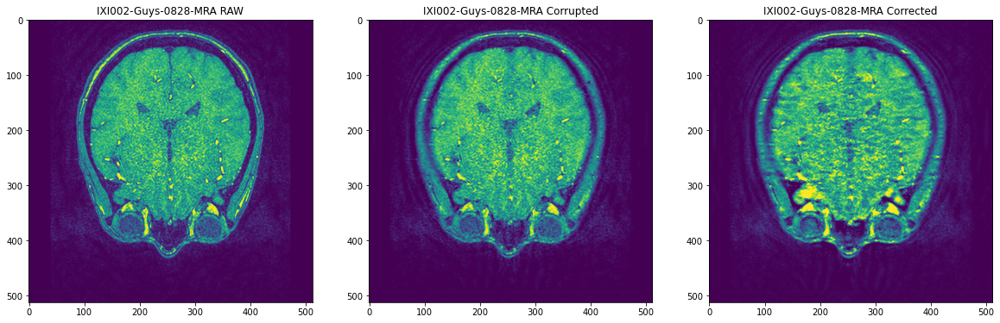

--------------------------------------------------------------------------------------------------------------------------------------------------------


In [5]:
raw_tomo_path = os.path.join(ISONET_PATH, 'brain_dummyData_rotated/brain_corrupted/')
mask_tomo_path = os.path.join(ISONET_PATH, 'brain_dummyData_rotated/tomos_mask/')
corrected_tomo_path = os.path.join(ISONET_PATH, 'brain_dummyData_rotated/corrected_i30/')

img_base_path = os.path.join(PARENT_PATH, 'data/ixi_dataset/')

names = ['IXI002-Guys-0828-MRA']

mean_gt_vs_corrupt_ssim = []
mean_gt_vs_corrected_ssim = []

mean_gt_vs_corrupt_nmi = []
mean_gt_vs_corrected_nmi = []

for i in names:
    gt_data = os.path.join(img_base_path, '%s.nii.gz'%i)
    gt_data = read_array(gt_data)
    # standardize
    gt_data = (gt_data-np.mean(gt_data))/np.std(gt_data)
    # clip values
    gt_data = np.clip(gt_data, np.quantile(gt_data, 0.005), np.quantile(gt_data, 0.995))
    
    corrupted_data = os.path.join(raw_tomo_path, '%s_corrupted_ae12_XYrot0.mrc'%i)
    corrupted_data = read_array(corrupted_data)
    # standardize first
    corrupted_data = (corrupted_data-np.mean(corrupted_data))/np.std(corrupted_data)
    # now clip according to ground truth values
    corrupted_data = np.clip(corrupted_data, np.min(gt_data), np.max(gt_data))
    
    corrected_data = os.path.join(corrected_tomo_path, '%s_corrupted_ae12_XYrot0_corrected.mrc'%i)
    corrected_data = read_array(corrected_data)
    # standardize first
    corrected_data = (corrected_data-np.mean(corrected_data))/np.std(corrected_data)
    # now clip according to ground truth values
    corrected_data = np.clip(corrected_data, np.min(gt_data), np.max(gt_data))
    
    # scale all
    gt_data = minmax_scaler(gt_data)
    corrupted_data = minmax_scaler(corrupted_data)
    corrected_data = minmax_scaler(corrected_data)
    
    gt_vs_corrupt_ssim, gt_vs_corrected_ssim = ssim(gt_data, corrupted_data), ssim(gt_data, corrected_data)
    mean_gt_vs_corrupt_ssim.append(gt_vs_corrupt_ssim)
    mean_gt_vs_corrected_ssim.append(gt_vs_corrected_ssim)
    
    gt_vs_corrupt_nmi, gt_vs_corrected_nmi = nmi(gt_data, corrupted_data), nmi(gt_data, corrected_data)
    mean_gt_vs_corrupt_nmi.append(gt_vs_corrupt_nmi)
    mean_gt_vs_corrected_nmi.append(gt_vs_corrected_nmi)
    
    print('- SSIM GT vs Corrupted: ', gt_vs_corrupt_ssim)
    print('- SSIM GT vs Corrected: ', gt_vs_corrected_ssim)
    print('- NMI GT vs Corrupted: ', gt_vs_corrupt_nmi)
    print('- NMI GT vs Corrected: ', gt_vs_corrected_nmi)
    
    fig, ax = plt.subplots(1, 3, figsize=(20, 15))
        
    z_idx = gt_data.shape[0]//2
    ax[0].imshow(gt_data[z_idx])
    ax[0].set_title(i + ' RAW')
    ax[1].imshow(corrupted_data[z_idx])
    ax[1].set_title(i + ' Corrupted')
    ax[2].imshow(corrected_data[z_idx])
    ax[2].set_title(i + ' Corrected')
    
    plt.show()
    
    print('--------------------------------------------------------------------------------------------------------------------------------------------------------')